In [1]:
import os
import json
import pandas as pd
import plotly.graph_objects as go


In [3]:
with open('../data/cleandata/harris_co_tracts.geojson') as response:
    tracts_data = json.load(response)

In [17]:
tracts_data['features'][0]

{'type': 'Feature',
 'properties': {'GEOID': '48201100000',
  'west': -95.3746,
  'south': 29.7449,
  'east': -95.3477,
  'north': 29.7706,
  'n': '1000',
  'pl': 'Harris County, Texas',
  'p-00': 6678.33,
  'pr-00': 40.41,
  'roh-00': 1091.0,
  'pro-00': 95.7,
  'mgr-00': 755.98,
  'mhi-00': 25968.11,
  'mpv-00': 27505.8,
  'rb-00': 26.7,
  'pw-00': 43.66,
  'paa-00': 35.31,
  'ph-00': 18.97,
  'pai-00': 0.13,
  'pa-00': 1.17,
  'pnp-00': 0.01,
  'pm-00': 0.7,
  'po-00': 0.03,
  'ef-00': None,
  'e-00': None,
  'er-00': None,
  'efr-00': None,
  'lf-00': 0.0,
  'imputed-00': 0.0,
  'subbed-00': 0.0,
  'p-01': 6678.33,
  'pr-01': 40.41,
  'roh-01': 1123.0,
  'pro-01': 95.7,
  'mgr-01': 755.98,
  'mhi-01': 25968.11,
  'mpv-01': 27505.8,
  'rb-01': 26.7,
  'pw-01': 43.66,
  'paa-01': 35.31,
  'ph-01': 18.97,
  'pai-01': 0.13,
  'pa-01': 1.17,
  'pnp-01': 0.01,
  'pm-01': 0.7,
  'po-01': 0.03,
  'ef-01': 45.0,
  'e-01': 26.0,
  'er-01': 2.32,
  'efr-01': 4.01,
  'lf-01': 1.0,
  'imputed-0

In [8]:
school_df = pd.read_csv('../data/cleandata/school_ratings_data.csv',dtype={"FIPS": str})

In [10]:
school_df = school_df.rename(columns={'FIPS':'GEOID'})

In [11]:
school_df.head()

,School,Street,Zip,City,Rating,GEOID
0,Frostwood Elementary School,12214 Memorial Drive,77024,Houston,10,48201430600
1,Memorial Drive Elementary School,11202 Smithdale Road,77024,Houston,10,48201430400
2,Rummel Creek Elementary School,625 Brittmoore Road,77079,Houston,10,48201450100
3,Wilchester Elementary School,13618 Saint Marys Lane,77079,Houston,10,48201450200
4,Bush Elementary School,13800 Westerloch Drive,77077,Houston,10,48201451601


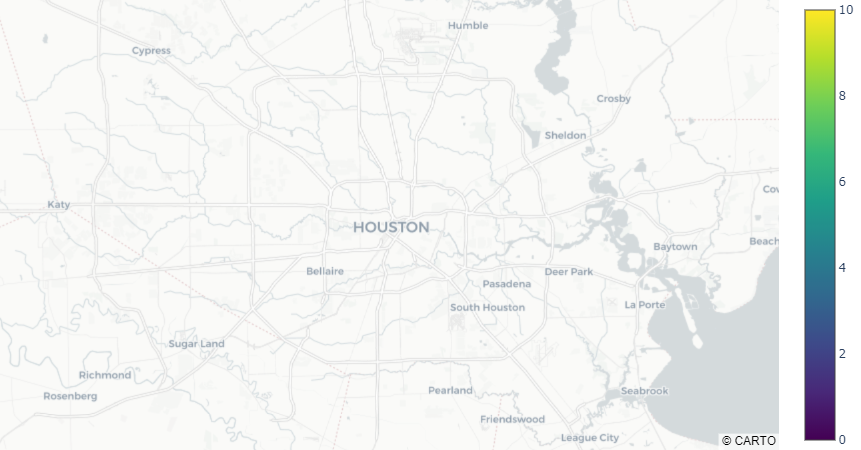

In [12]:
fig = go.Figure(go.Choroplethmapbox(geojson=tracts_data, locations=school_df.GEOID, z=school_df.Rating,
                                    colorscale="Viridis", zmin=0, zmax=10,
                                    marker_opacity=0.5, marker_line_width=0))

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=9, mapbox_center = {"lat": 29.7604, "lon": -95.3698})

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()